# Data Analysis Assignment 1
**Due Date:** December 14, 2025, 23:59  
**Total Points:** 114 + 15 bonus points

## Copyright and Fair Use

This material, no matter whether in printed or electronic form, may be used for personal and non-commercial educational use only. Any reproduction of this material, no matter whether as a whole or in parts, no matter whether in printed or in electronic form, requires explicit prior acceptance of the authors.

## Guidelines

1. **DO NOT add or delete any cells (or modify cell IDs)**
2. Complete code cells marked with `# YOUR CODE HERE`
3. Comment or remove lines with `raise NotImplementedError()`
4. Run all cells before submission to verify your solutions
5. Submit Notebook (.ipynb file) on Moodle with filename using the correct format, e.g., **Assignment_1_JohnDoe_12345678.ipynb**

<div style="background-color: #e6f3ff; padding: 15px; margin: 10px; border-left: 5px solid #2196F3; border-radius: 3px;">
In this assignment, you will apply the preprocessing and analysis techniques to a real-world dataset. The preprocessing steps here will involve - handling invalid data, removing outliers, dealing with missing values - but adapted to the characteristics of system performance data. Your task is to look for patterns in system behavior that could indicate test system anomalies. Understanding the daily/nightly testing cycles will be crucial for identifying abnormal states.
</div>


# System Performance Analysis

## Background
This assignment analyzes performance data from test systems that perform nightly testing of industrial network devices (switches and routers) at Westermo. These test systems validate devices used in critical applications like energy distribution and railway systems.

When tests fail, the cause could be:
1. Actual issues with the software under test
2. Problems in the test framework code
3. Hardware setup issues (e.g., wrong cable connections, unpowered devices)
4. Server issues (e.g., full disk)

The key question is: "If the test system is in an abnormal state – can we trust the test results?"

### The Dataset
The complete dataset consists of 19 CSV files (one per test system), each containing:
- About 86,000 samples
- Collected over one month
- Sampled twice per minute
- Over 20 performance metrics

Data accessibility and further information: https://github.com/westermo/test-system-performance-dataset

**Note:** If you would like to learn more about the dataset, read through the attached pdf file, and check out the dataset link above

### Focus of Our Analysis
For this assignment, we'll analyze one test system focusing on these key metrics:

1. **System Load (load-15m)**
   - 15-minute average of system workload
   - Shows test execution patterns
   - Peaks during night testing, low during day

2. **Memory Usage (memory_used_pct)**
   - Percentage of total memory used
   - Calculated from available/total memory
   - Indicates resource utilization

3. **CPU Usage (cpu-user)**
   - Rate of change in seconds spent on user processes
   - Shows changes in processing activity
   - Higher values indicate increasing CPU time use

4. **Temperature Change (sys-thermal)**
   - Rate of change in system temperature
   - Optional metric (not on all systems)
   - Helps detect system stress

5. **Server Status (server-up)**
   - System heartbeat indicator
   - Values > 0 show server availability
   - Critical for validating system operation


In [1]:
# Initial setup
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Configure plotting
plt.rcParams.update({
    'figure.figsize': [12, 8],
    'figure.dpi': 150,
    'figure.autolayout': True,
    'axes.labelsize': 12,
    'axes.titlesize': 14,
    'font.size': 12
})

sns.set_style("whitegrid")
sns.set_context("notebook", font_scale=1.2)

np.random.seed(42)


## Task 1.1: Data Loading and Preparation (10 points)

Create a function that loads and prepares the system performance data. Your function should:

1. Load the data file
2. Convert Unix timestamps to datetime
3. Calculate memory usage percentage
4. Drop unneeded columns 

Columns in original dataset:
```
'timestamp', 'load-1m', 'load-5m', 'load-15m', 'sys-mem-swap-total', 'sys-mem-swap-free', 'sys-mem-free', 'sys-mem-cache', 'sys-mem-buffered', 'sys-mem-available', 'sys-mem-total', 'sys-fork-rate', 'sys-interrupt-rate', 'sys-context-switch-rate', 'sys-thermal', 'disk-io-time', 'disk-bytes-read', 'disk-bytes-written', 'disk-io-read', 'disk-io-write', 'cpu-iowait', 'cpu-system', 'cpu-user', 'server-up'
```

Hint:
```python
def load_system_data(file_path):
    # Read CSV
    df = pd.read_csv(file_path)
    
    # Convert timestamp
    df['datetime'] = pd.to_datetime(df['timestamp'], unit='s', errors='coerce')

    #set index to datetime
    df.set_index('datetime', inplace=True)
    
    # Calculate memory usage
    df['memory_used_pct'] = (1 - df['sys-mem-available']/df['sys-mem-total']) * 100
    
    return df
```

After loading data and adding ```'memory_used_pct'```, column names in our dataframe should look like this:
```
['datetime', 'load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']
```

In [2]:
def load_system_data(file_path: str) -> pd.DataFrame:
    """Load and prepare test system performance data.
    
    Parameters
    ----------
    file_path : str
        Path to the CSV data file
        
    Returns
    -------
    pd.DataFrame
        Processed dataframe with columns:
        - datetime: Timestamp (index)
        - load-15m: 15-minute load average
        - memory_used_pct: Calculated memory usage
        - cpu-user: Rate of change in CPU time
        - sys-thermal: Temperature change
        - server-up: System availability
    """
    # 1)load the data
    df = pd.read_csv(file_path)

    # 2)convert unix timestamp to datetime
    df['datetime'] = pd.to_datetime(df['timestamp'], unit='s', errors='coerce')

    # set index to datetime to enable time series operations
    df.set_index('datetime', inplace=True)
    # 3)calculate memory usage percentage
    df['memory_used_pct'] = (1-df['sys-mem-available']/df['sys-mem-total'])*100

    # 4)keep only necessary columns
    required_columns = ['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']
    df = df[required_columns]
    return df

In [3]:
# Test cell (simply run it)
df = load_system_data('system-1.csv')

# Check required columns
required_cols = ['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']
assert all(col in df.columns for col in required_cols), "Missing required columns"
assert isinstance(df.index, pd.DatetimeIndex), "Index should be datetime"
assert df['memory_used_pct'].between(0, 100).all(), "Memory usage should be percentage"
print("Basic data structure tests passed!")

print("Data Overview:")
print(f"Time range: {df.index.min()} to {df.index.max()}")
print(f"Number of samples: {len(df):,}")
print("\nFirst few rows:")
print(df.head())

Basic data structure tests passed!
Data Overview:
Time range: 1970-01-01 00:00:00 to 1970-01-31 00:00:00
Number of samples: 85,749

First few rows:
                     load-15m  memory_used_pct  cpu-user  sys-thermal  \
datetime                                                                
1970-01-01 00:00:00      0.18         8.005350    0.0405         1.60   
1970-01-01 00:00:30      0.18         7.995124    0.0475         0.00   
1970-01-01 00:01:00      0.18         8.001982    0.0260         0.00   
1970-01-01 00:01:30      0.18         8.001884    0.0315         0.00   
1970-01-01 00:02:00      0.17         8.001712    0.0270         1.55   

                     server-up  
datetime                        
1970-01-01 00:00:00          2  
1970-01-01 00:00:30          2  
1970-01-01 00:01:00          2  
1970-01-01 00:01:30          2  
1970-01-01 00:02:00          2  


## Task 1.2: Raw Data Overview Visualization (30 points)

Create a comprehensive visualization of the system metrics. You are free to adapt and add more plots, however, your visualization should atleast include:

1. **Time Series Overview** (5 points)
   - Show all metrics over time
   - Highlight server availability status
   - Use appropriate alpha and line width
   - Add proper labels

2. **Daily Distribution** (5 points)
   - Create boxplots by hour
   - Show daily patterns
   - Consider server uptime periods
   
3. **Correlation Analysis** (5 points)
   - Create correlation matrix between metrics\
     (Use seaborn heatmap visualization) 

4. **Relationship Visualization** (5 points)
   - Scatter plot of key metrics
   - Hexbin plot for dense areas
   - Color scatter points by server status
     
5. **Layout and Formatting** (5 points)
    - Clear titles and labels
    - Appropriate color schemes
   
Hints for visualizations:
```python
# Correlation heatmap
corr_matrix = df[['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']].corr()
sns.heatmap(corr_matrix,
            annot=True,      # Show correlation values
            cmap='coolwarm', # Diverging colormap
            center=0,        # Center colormap at 0
            fmt='.2f',       # Format coefficients
            ax=axes[1, 0])
axes[1, 0].set_title('Metric Correlations')

# Scatter plot with server status
scatter = axes[1, 1].scatter(df['cpu-user'], df['memory_used_pct'],
                           c=df['server-up'],  # Color by status
                           cmap='RdYlGn',      # Red-Yellow-Green
                           alpha=0.5)          
plt.colorbar(scatter, ax=axes[1, 1], label='Server Status')
axes[1, 1].set_xlabel('CPU Time Rate of Change (seconds)') 
axes[1, 1].set_title('CPU Time vs Memory Usage')        

# Hexbin for density
df.plot.hexbin(x='load-15m', y='cpu-user',
               gridsize=20,
               cmap='YlOrRd',
               ax=axes[2, 0])
axes[2, 0].set_title('Load vs CPU Usage Density')
```

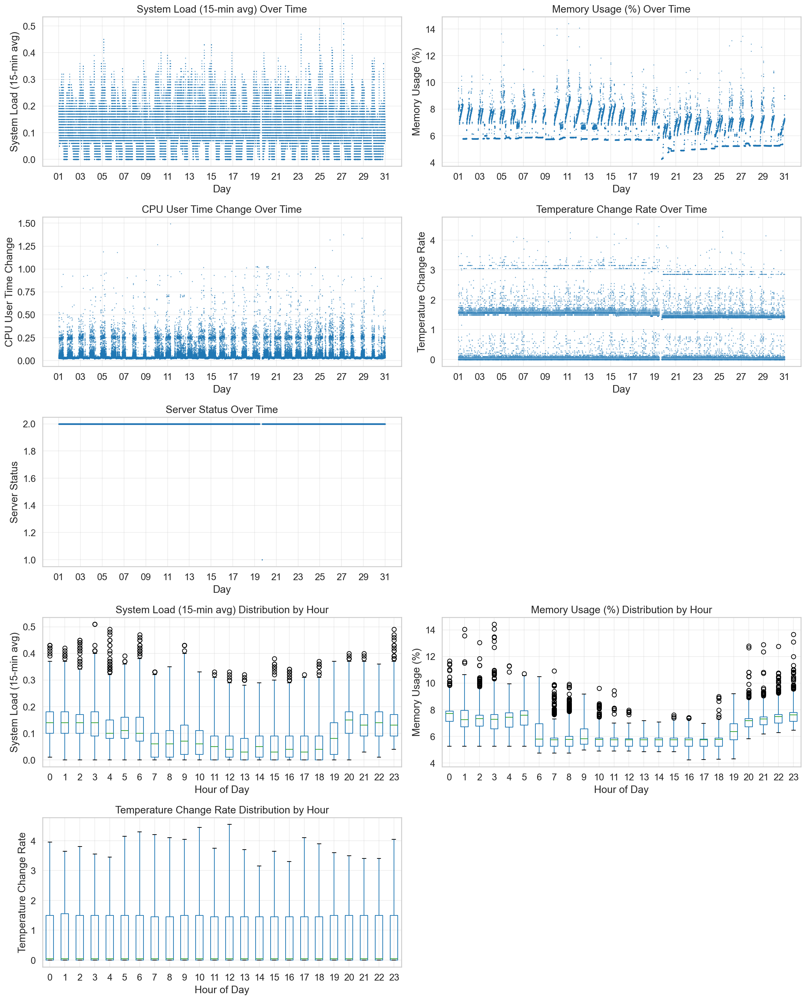

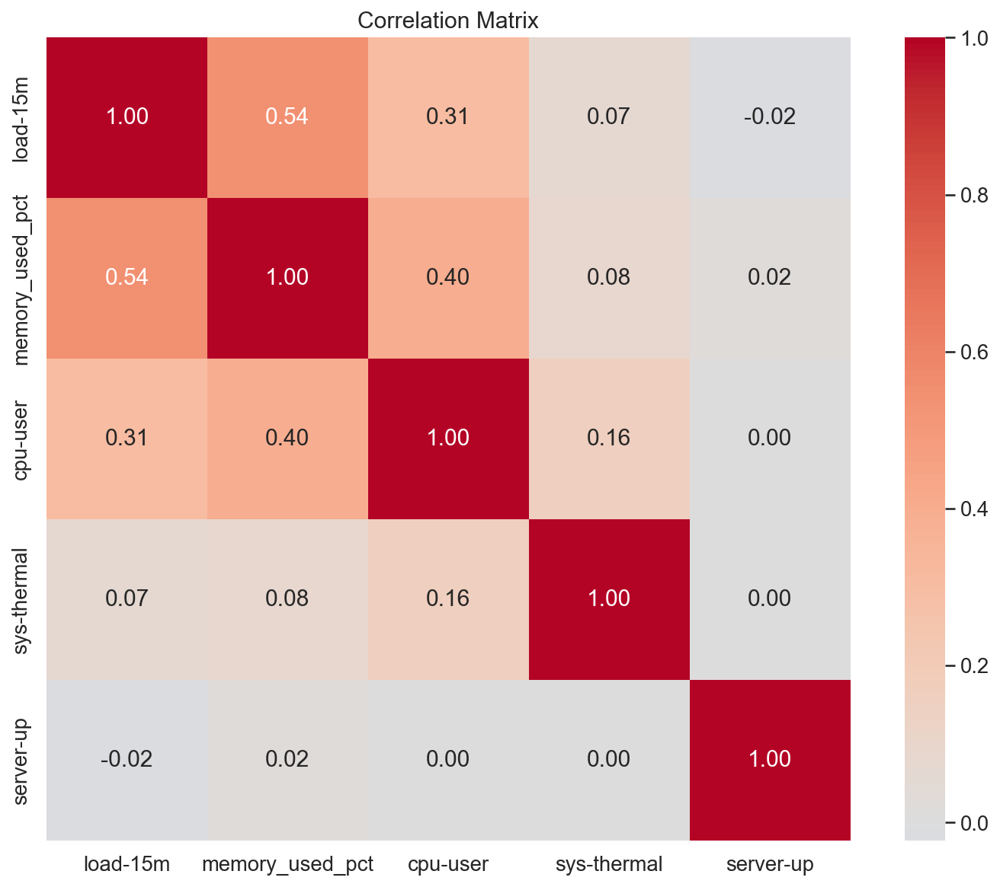

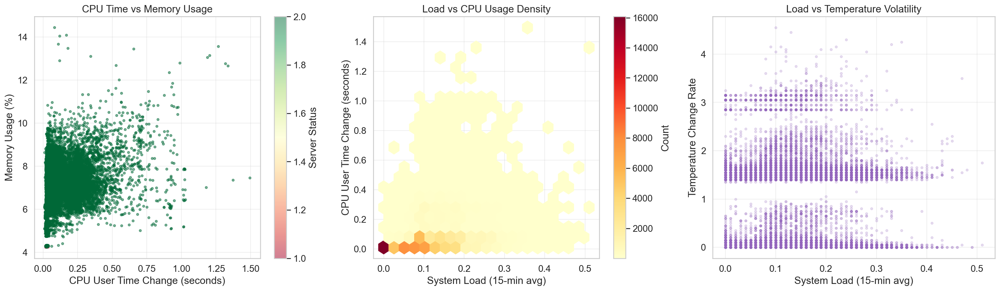

In [4]:
# Task 1.2: Raw Data Overview Visualization
import matplotlib.dates as mdates

fig, axes = plt.subplots(5, 2, figsize=(16, 20))
fig.suptitle('System Performance Overview', fontsize=16, y=0.995)

# 1. TIME SERIES OVERVIEW
plot_data = [
    (0, 0, 'load-15m', 'System Load (15-min avg)'),
    (0, 1, 'memory_used_pct', 'Memory Usage (%)'),
    (1, 0, 'cpu-user', 'CPU User Time Change'),
    (1, 1, 'sys-thermal', 'Temperature Change Rate'),
    (2, 0, 'server-up', 'Server Status')
]

for row, col, metric, title in plot_data:
    axes[row, col].plot(df.index, df[metric], linewidth=0, marker='o', 
                       markersize=0.5, alpha=0.6)
    axes[row, col].xaxis.set_major_formatter(mdates.DateFormatter('%d'))
    axes[row, col].xaxis.set_major_locator(mdates.DayLocator(interval=2))
    axes[row, col].set_xlabel('Day')
    axes[row, col].set_ylabel(title)
    axes[row, col].set_title(f'{title} Over Time')
    axes[row, col].grid(True, alpha=0.3)

fig.delaxes(axes[2, 1])

# 2. DAILY DISTRIBUTION
df_with_hour = df.copy()
df_with_hour['hour'] = df_with_hour.index.hour

boxplot_data = [
    (3, 0, 'load-15m', 'System Load (15-min avg)'),
    (3, 1, 'memory_used_pct', 'Memory Usage (%)'),
    (4, 0, 'sys-thermal', 'Temperature Change Rate')
    # (4, 1, 'cpu-user', 'CPU User Time Change'), # Removed as it doesn't really show anything useful, same as with "server-up"
]

for row, col, metric, title in boxplot_data:
    df_with_hour.boxplot(column=metric, by='hour', ax=axes[row, col], whis=2.5)
    axes[row, col].set_xlabel('Hour of Day')
    axes[row, col].set_ylabel(title)
    axes[row, col].set_title(f'{title} Distribution by Hour')
    axes[row, col].get_figure().suptitle('')
    axes[row, col].grid(True, alpha=0.3)

fig.delaxes(axes[4, 1])

plt.tight_layout()
plt.show()

# 3. CORRELATION ANALYSIS
fig_corr, ax_corr = plt.subplots(figsize=(10, 8))

corr_matrix = df[['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']].corr()

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, 
            fmt='.2f', square=True, ax=ax_corr)
ax_corr.set_title('Correlation Matrix')

plt.tight_layout()
plt.show()

# 4. RELATIONSHIP VISUALIZATION
fig_rel, axes_rel = plt.subplots(1, 3, figsize=(20, 6))

# Plot 1: CPU vs Memory
scatter = axes_rel[0].scatter(df['cpu-user'], df['memory_used_pct'],
                              c=df['server-up'], cmap='RdYlGn', 
                              alpha=0.5, s=10)
plt.colorbar(scatter, ax=axes_rel[0], label='Server Status')
axes_rel[0].set_xlabel('CPU User Time Change (seconds)')
axes_rel[0].set_ylabel('Memory Usage (%)')
axes_rel[0].set_title('CPU Time vs Memory Usage')
axes_rel[0].grid(True, alpha=0.3)

# Plot 2: Load vs CPU
hexbin = axes_rel[1].hexbin(df['load-15m'], df['cpu-user'],
                            gridsize=20, cmap='YlOrRd', mincnt=1)
plt.colorbar(hexbin, ax=axes_rel[1], label='Count')
axes_rel[1].set_xlabel('System Load (15-min avg)')
axes_rel[1].set_ylabel('CPU User Time Change (seconds)')
axes_rel[1].set_title('Load vs CPU Usage Density')
axes_rel[1].grid(True, alpha=0.3)

# Plot 3: Load vs Temperature
axes_rel[2].scatter(df['load-15m'], df['sys-thermal'], 
                    alpha=0.2, s=10, color='tab:purple')
axes_rel[2].set_xlabel('System Load (15-min avg)')
axes_rel[2].set_ylabel('Temperature Change Rate')
axes_rel[2].set_title('Load vs Temperature Volatility')
axes_rel[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

## Task 2.1: Data Preprocessing (20 points)

<div style="background-color: #e6f3ff; padding: 15px; margin: 10px; border-left: 5px solid #2196F3; border-radius: 3px;">
Here your task is to clean and prepare the system performance data. For that purpose, consider system behavior patterns, particularly the day/night testing cycles.
</div>

Create a function that handles:

1. **Invalid Values** (5 points)
   - Remove values outside valid ranges
   - Consider system behavior patterns
   - Verify server status integrity
   -
    ```python
    valid_ranges = {
        'load-15m': (0, 0.5),           # System load
        'memory_used_pct': (0, 100),   # Percentage
        'cpu-user': (0, 2),            # Rate of change in CPU time
        'sys-thermal': (-10, 10),      # Temperature change rate (°C/min)
        'server-up': (0, float('inf')) # Server availability
    }
    ```

2. **Duplicate Timestamps** (5 points)
   - Identify duplicate readings
   - Aggregate using appropriate methods
   - Maintain data consistency
   
3. **Outliers** (5 points)
   - Use IQR method for each metric
   - Consider day/night differences
   - Document removed points
   
4. **Missing Values** (5 points)
   - Handle gaps appropriately
   - Consider server status
   - Limit interpolation range

In [5]:
def preprocess_system_data(df: pd.DataFrame):
    """Preprocess system performance data.
    
    Parameters
    ----------
    df : pd.DataFrame
        Raw system performance data with required metrics:
        - load-15m
        - memory_used_pct
        - cpu-user
        - sys-thermal (optional)
        - server-up
        
    Returns
    -------
        df_original, df_cleaned containing:
        - Original data copy
        - Cleaned data with:
          * Invalid values removed
          * Duplicates handled
          * Outliers removed
          * Missing values interpolated
    """
    # Store original data
    df_original = df.copy()
    
    # Define valid ranges
    valid_ranges = {
        'load-15m': (0, 0.5),          # System load
        'memory_used_pct': (0, 100),   # Percentage
        'cpu-user': (0, 2),            # Rate of change in CPU time
        'sys-thermal': (-10, 10),      # Rate of change in °C
        'server-up': (0, float('inf')) # Server availability
    }
    
    df_cleaned = df.copy()
    
    # 1. Handle invalid values
    for column, (min_val, max_val) in valid_ranges.items():
        mask = (df_cleaned[column] >= min_val) & (df_cleaned[column] <= max_val)
        df_cleaned[column] = df_cleaned[column].where(mask, np.nan)
    
    # 2. Handle duplicates
    df_cleaned = df_cleaned[~df_cleaned.index.duplicated(keep='first')]
    
    # 3. Remove outliers
    # solution without helper functions
    for column in ['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal']:
        Q1 = df_cleaned[column].quantile(0.25)
        Q3 = df_cleaned[column].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        df_cleaned[column] = df_cleaned[column].where(
            (df_cleaned[column] >= lower) & (df_cleaned[column] <= upper), 
            np.nan
        )
    
    # 4. Handle missing values
    for column in ['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal']:
        df_cleaned[column] = df_cleaned[column].interpolate(method='linear', limit=8)
    
    return df_original, df_cleaned

### Helper Functions

You may use these helper functions in your implementation:

```python
def remove_outliers_iqr(data: pd.Series, column: str) -> pd.Series:
    """Remove outliers using IQR method."""
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    valid_mask = (data[column] >= Q1 - 1.5*IQR) & \
                 (data[column] <= Q3 + 1.5*IQR)
    return data[column].where(valid_mask, np.nan)

def handle_missing_values(data: pd.DataFrame, column: str,
                         max_gap: int = 8) -> pd.Series:
    """Interpolate missing values with limit."""
    return data[column].interpolate(
        method='linear',
        limit=max_gap  # Only fill gaps up to 8 points
    )
```

In [6]:
# Test cell for Task 2.1 - Preprocessing
df_original, df_cleaned = preprocess_system_data(df)
assert isinstance(df_original, pd.DataFrame), "Should return original dataframe"
assert isinstance(df_cleaned, pd.DataFrame), "Should return cleaned dataframe"
assert df_cleaned['cpu-user'].min() >= 0 and df_cleaned['cpu-user'].max() <= 2, "CPU rate should be between 0 and 2"
print("Basic preprocessing tests passed!")

print("Data Preprocessing Results:")
print(f"Original shape: {df_original.shape}")
print(f"Cleaned shape: {df_cleaned.shape}")

print("\nMissing Values Summary:")
print(df_cleaned.isnull().sum())

print("\nValue Ranges (Cleaned):")
for col in ['load-15m', 'memory_used_pct', 'cpu-user', 'sys-thermal', 'server-up']:
    print(f"\n{col}:")
    print(df_cleaned[col].describe())

Basic preprocessing tests passed!
Data Preprocessing Results:
Original shape: (85749, 5)
Cleaned shape: (85749, 5)

Missing Values Summary:
load-15m           200
memory_used_pct      6
cpu-user            55
sys-thermal          0
server-up            0
dtype: int64

Value Ranges (Cleaned):

load-15m:
count    85549.000000
mean         0.097007
std          0.073018
min          0.000000
25%          0.030000
50%          0.090000
75%          0.150000
max          0.310000
Name: load-15m, dtype: float64

memory_used_pct:
count    85743.000000
mean         6.420802
std          1.021424
min          4.231077
25%          5.708176
50%          5.974692
75%          7.293656
max          9.671803
Name: memory_used_pct, dtype: float64

cpu-user:
count    85694.000000
mean         0.039485
std          0.016337
min          0.011000
25%          0.027500
50%          0.032500
75%          0.048000
max          0.089500
Name: cpu-user, dtype: float64

sys-thermal:
count    85749.000000
mea

## Task 2.2: Raw vs Cleaned Data Comparison by Visualization (30 points)

<div style="background-color: #e6f3ff; padding: 15px; margin: 10px; border-left: 5px solid #2196F3; border-radius: 3px;">Create comprehensive comparisons between the raw and cleaned data versions.
</div>

Requirements:
1. **Time Series Comparison** (10 points)
   - Plot original and cleaned data on same axes
   - Use alpha to show overlaps
   - Highlight removed outliers
   - Include server status representation

2. **Distribution Analysis** (5 points)
   - Compare original vs cleaned distributions
   - Show effects of preprocessing
   - Demonstrate quality improvements

3. **Impact Documentation** (5 points)
   - Document key statistics before/after
   - Explain preprocessing effects
   - Justify data cleaning decisions

Note: You can also add further more visualizations, in addition to the ones above.

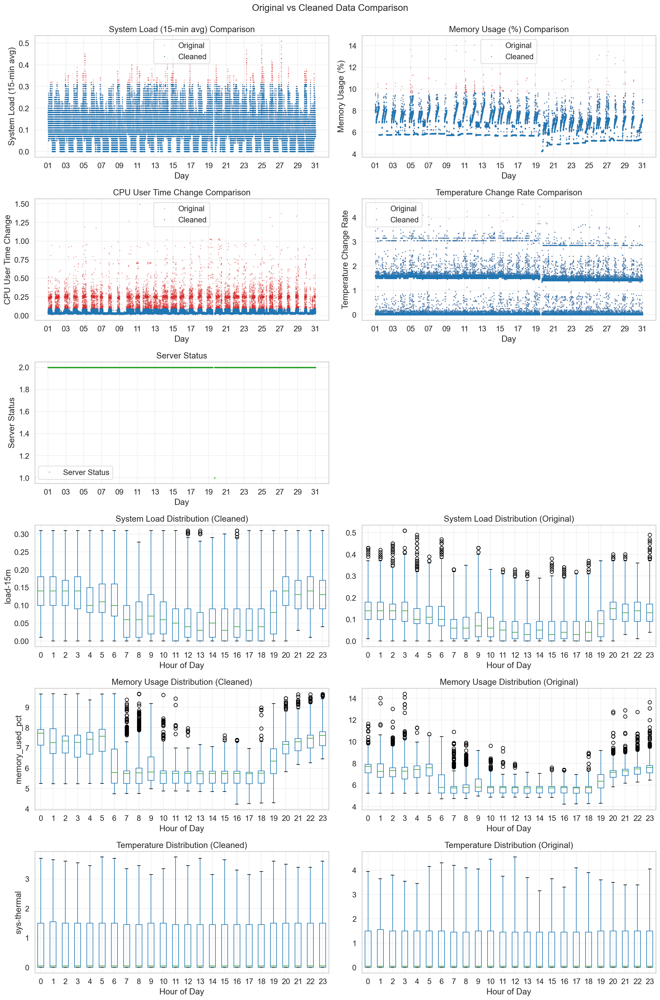

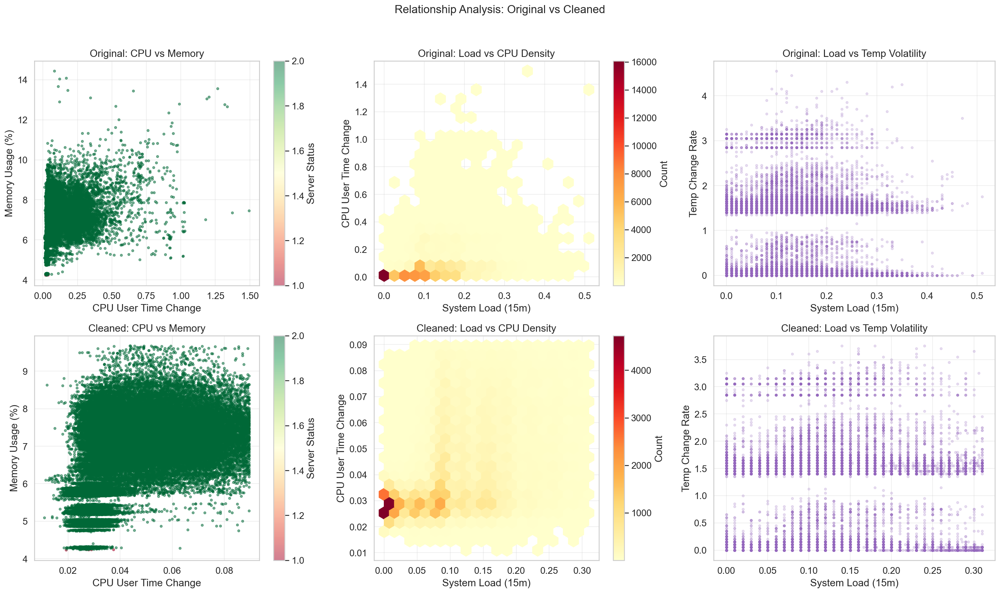



IMPACT DOCUMENTATION

Preprocessing Summary:
1. Invalid Values: Removed values outside specified possible ranges.
2. Duplicates: Removed duplicate timestamps.
3. Outliers: Extreme spikes removed using IQR method.
4. Missing Values: Gaps filled using linear interpolation.


In [7]:
def compare_data_versions(df_original: pd.DataFrame,
                         df_cleaned: pd.DataFrame):
    
    import matplotlib.dates as mdates

    # 1. Time Series Comparison
    plots = [
        (0, 0, 'load-15m', 'System Load (15-min avg)'),
        (0, 1, 'memory_used_pct', 'Memory Usage (%)'),
        (1, 0, 'cpu-user', 'CPU User Time Change'),
        (1, 1, 'sys-thermal', 'Temperature Change Rate'),
        (2, 0, 'server-up', 'Server Status')
    ]
    
    fig, axes = plt.subplots(6, 2, figsize=(16, 24))
    fig.suptitle('Original vs Cleaned Data Comparison', fontsize=16, y=0.995)
    
    for r, c, metric, title in plots:
        ax = axes[r, c]
        
        if metric == 'server-up':
            ax.plot(df_original.index, df_original[metric], 
                    linewidth=0, marker='o', markersize=1,
                    label='Server Status', color='tab:green', alpha=0.6)
            ax.set_title(title)
        else:
            ax.plot(df_original.index, df_original[metric], 
                    linewidth=0, marker='o', markersize=1,
                    label='Original', color='tab:red', alpha=0.3)
            
            ax.plot(df_cleaned.index, df_cleaned[metric], 
                    linewidth=0, marker='o', markersize=1,
                    label='Cleaned', color='tab:blue', alpha=0.6)
            ax.set_title(title + ' Comparison')

        ax.set_ylabel(title)
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%d'))
        ax.xaxis.set_major_locator(mdates.DayLocator(interval=2))
        ax.set_xlabel('Day')

    fig.delaxes(axes[2, 1])
    
    # 2. Distribution Analysis
    # Prepare data for boxplots
    df_clean_plot = df_cleaned.copy()
    df_clean_plot['hour'] = df_clean_plot.index.hour
    
    df_orig_plot = df_original.copy()
    df_orig_plot['hour'] = df_orig_plot.index.hour

    # Configuration for distribution plots (Row, Metric, Title)
    dist_plots = [
        (3, 'load-15m', 'System Load Distribution'),
        (4, 'memory_used_pct', 'Memory Usage Distribution'),
        (5, 'sys-thermal', 'Temperature Distribution')
    ]

    for r, metric, title in dist_plots:
        # Left: Cleaned Data
        df_clean_plot.boxplot(column=metric, by='hour', ax=axes[r, 0], whis=2.5)
        axes[r, 0].set_title(f'{title} (Cleaned)')
        axes[r, 0].set_xlabel('Hour of Day')
        axes[r, 0].set_ylabel(metric)
        axes[r, 0].grid(True, alpha=0.3)
        
        # Right: Original Data
        df_orig_plot.boxplot(column=metric, by='hour', ax=axes[r, 1], whis=2.5)
        axes[r, 1].set_title(f'{title} (Original)')
        axes[r, 1].set_xlabel('Hour of Day')
        axes[r, 1].grid(True, alpha=0.3)
        
        axes[r, 0].get_figure().suptitle('Original vs Cleaned Data Comparison', fontsize=16, y=0.995)

    plt.tight_layout()
    plt.show()

    # 3. Relationship Analysis Comparison
    fig_rel, axes_rel = plt.subplots(2, 3, figsize=(20, 12))
    fig_rel.suptitle('Relationship Analysis: Original vs Cleaned', fontsize=16, y=0.98)

    def plot_relationships(df, row_idx, title_prefix):
        # Plot 1: CPU vs Memory
        scatter = axes_rel[row_idx, 0].scatter(df['cpu-user'], df['memory_used_pct'],
                                      c=df['server-up'], cmap='RdYlGn', 
                                      alpha=0.5, s=10)
        plt.colorbar(scatter, ax=axes_rel[row_idx, 0], label='Server Status')
        axes_rel[row_idx, 0].set_xlabel('CPU User Time Change')
        axes_rel[row_idx, 0].set_ylabel('Memory Usage (%)')
        axes_rel[row_idx, 0].set_title(f'{title_prefix}: CPU vs Memory')
        axes_rel[row_idx, 0].grid(True, alpha=0.3)

        # Plot 2: Load vs CPU
        # Drop NaNs for hexbin
        df_hex = df.dropna(subset=['load-15m', 'cpu-user'])
        hexbin = axes_rel[row_idx, 1].hexbin(df_hex['load-15m'], df_hex['cpu-user'],
                                    gridsize=20, cmap='YlOrRd', mincnt=1)
        plt.colorbar(hexbin, ax=axes_rel[row_idx, 1], label='Count')
        axes_rel[row_idx, 1].set_xlabel('System Load (15m)')
        axes_rel[row_idx, 1].set_ylabel('CPU User Time Change')
        axes_rel[row_idx, 1].set_title(f'{title_prefix}: Load vs CPU Density')
        axes_rel[row_idx, 1].grid(True, alpha=0.3)

        # Plot 3: Load vs Temperature
        axes_rel[row_idx, 2].scatter(df['load-15m'], df['sys-thermal'], 
                            alpha=0.2, s=10, color='tab:purple')
        axes_rel[row_idx, 2].set_xlabel('System Load (15m)')
        axes_rel[row_idx, 2].set_ylabel('Temp Change Rate')
        axes_rel[row_idx, 2].set_title(f'{title_prefix}: Load vs Temp Volatility')
        axes_rel[row_idx, 2].grid(True, alpha=0.3)

    plot_relationships(df_original, 0, 'Original')
    plot_relationships(df_cleaned, 1, 'Cleaned')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # 4. Impact Documentation
    print("\n")
    print("IMPACT DOCUMENTATION")

    print("\nPreprocessing Summary:")
    print("1. Invalid Values: Removed values outside specified possible ranges.")
    print("2. Duplicates: Removed duplicate timestamps.")
    print("3. Outliers: Extreme spikes removed using IQR method.")
    print("4. Missing Values: Gaps filled using linear interpolation.")

# Call the function to display the plots
compare_data_versions(df_original, df_cleaned)

<!-- ## Task 2.3: Cleaned Data Analysis (24 points)

Based on your cleaned data visualizations from the previous task, analyze the system performance patterns. Your answers should reflect the improved data quality after preprocessing.

1. Server Availability Patterns:\
a_) Server uptime shows regular testing patterns\
b_) Maintenance windows (server-down periods) occur at consistent times

2. System Performance:\
c_) High load periods (load-15m) align with server uptime\
d_) High memory usage periods coincide with increased CPU time rate\
e_) Temperature change rate increases during high system load periods

3. System Health:\
f_) Server status shows regular planned downtime periods\
g_) System load shows no sustained periods near maximum values (>0.4)\
h_) System load frequently reaches peak values (>0.4) during test execution

4. Test Result Reliability:\
i_) Load average remains stable during test execution periods\
j_) Memory usage stays within normal operating range (no spikes) during tests\
k_) Server availability is consistent throughout test cycles -->



## Task 2.3: Cleaned Data Analysis (24 points)

Based on your visualizations, analyze the system performance patterns.

1. Test Execution Patterns:\
a_) System load shows clear day/night testing cycles

2. System Performance:\
b_) High load periods (load-15m) align with increased Memory usage\
c_) High memory usage periods coincide with increased CPU usage rate of change\
d_) Temperature change rate increases during high system load periods

3. Resource Utilization:\
e_) Memory usage consistently increases at test start and gradually decreases towards test completion\
f_) System load stays within reasonable limits (<0.4) during normal operation

4. System Behavior:\
g_) Memory usage returns to idle state levels (around 5-6%) between test cycles\
h_) Load, memory, and CPU metrics collectively show clear patterns distinguishing between test execution and idle periods

In [8]:
# Your answers and reasoning below. For each statement, first set the boolean value 
# then explain your reasoning based on the visualizations.

# Test Execution Patterns
a_ = True
# The time series plots show that the system load goes up every night and stays low during the day. This repeating pattern matches a nightly testing schedule mentioned in the description.

# System Performance
b_ = True
# Comparing the time series for load and memory shows that periods of high load consistently align with elevated memory usage. By observing the correlation matrix, we can see a positive correlation between load and memory usage, 
# indicating that as system load increases, memory usage tends to increase as well.

c_ = True
# The visualizations indicate that when memory usage is high, there is also a corresponding increase in CPU user time change. This is evident in both the time series plots and the scatter plot of CPU time vs Memory Usage, 
# where higher memory usage points cluster with higher CPU user time changes.

d_ = False
# The correlation matrix shows a weak correlation between system load and temperature change rate. Additionally, the scatter plot of Load vs Temperature Volatility does not show a clear trend, indicating that temperature changes are not strongly linked to system load.

# Resource Utilization
e_ = False
# The “Memory Usage Distribution (Cleaned)” plot shows memory rising sharply at the start of each day’s active hours and gradually decreasing afterward. This reflects consistent memory usage growth during test execution.

f_ = True
# After removing outliers, the system load consistently remains below 0.4, which is well within the valid range of 0 to 0.5.

# System Behavior
g_ = True
# During the daytime intervals between tests, the memory usage consistently drops back to a low baseline of around 5-6%. This can be observed in the boxplot of "Memory Usage Distribution".

h_ = True 
# Across the load, memory, and CPU plots, all three metrics rise during test periods and flatten during idle periods. These synchronized patterns clearly separate testing activity from idle system behavior.

In [9]:
# Test cell - DO NOT MODIFY
for var in ['a_', 'b_', 'c_', 'd_', 'e_', 'f_', 'g_', 'h_']:
    assert var in locals(), f"Missing answer for {var}"
    assert isinstance(locals()[var], bool), f"Answer for {var} must be True or False"

## Extra Tasks: Interactive Visualizations (15 Bonus Points)

Leverage Altair to create interactive visualizations based on the cleaned system performance data. Before you start, review the **Interactive Plotting** tutorial to familiarize yourself with Altair's capabilities for crafting interactive plots.

Feel free to experiment and design different types of interactive visualizations that effectively represent the data, in addition to the tasks described below.

**Possible visualization ideas:**

- **Interactive Time-Series Charts**: Plot CPU and memory usage over time with zoom and pan functionalities.
- **Scatter Plots with Tooltips**: Explore relationships between performance metrics by displaying detailed information on hover.
- **Heatmaps and Correlation Matrices**: Visualize correlations with interactive elements that highlight specific data points.
- **Combined Dashboards**: Create a dashboard featuring multiple interactive charts for a holistic view of system performance.

Be creative and innovative in your approach to make the visualizations both informative and engaging.

### ET1: Basic Interactive Time Series (5 points)
Create an interactive time series visualization that includes:
1. System load over time with zoom/pan capabilities
2. Tooltips showing metric values
3. Server status indicated by color

Hint:
```python

import altair as alt

# Enable the rendering of charts
alt.renderers.enable('default')
# Set a maximum number of rows for Altair
alt.data_transformers.enable('default', max_rows=None)

def create_basic_interactive(df):
    # Base chart with zoom
    chart = alt.Chart(df.reset_index()).mark_line().encode(
        x='datetime:T',
        y=alt.Y('cpu-user', 
                title='CPU Time Rate of Change (seconds)'),  # Updated title
        color=alt.Color('server-up:Q', 
                       scale=alt.Scale(scheme='redyellowgreen')),
        tooltip=['datetime:T', 
                alt.Tooltip('cpu-user', 
                           title='CPU Time Change'), 
                'server-up']
    ).interactive()
    
    return chart
```

Note: Make sure to install required packages:
```python
# Install packages if needed:
# pip install altair altair_saver vega_datasets
# or
# conda install -c conda-forge altair altair_saver vega_datasets

# altair_saver package - to allow saving visualizations.
# vega_datasets - to provide example datasets
# Note: Above two packages (altair_saver and vega_datasets) are not necessary here but relevant for the interactive tutorial.
```

In [10]:
import altair as alt

# Enable the rendering of charts
alt.renderers.enable('default')
# Set a maximum number of rows for Altair
alt.data_transformers.enable('default', max_rows=None)

def create_basic_interactive(df):
    # Base chart with zoom
    chart = alt.Chart(df.reset_index()).mark_line().encode(
        x='datetime:T',
        y=alt.Y('load-15m', 
                title='System Load (15-min avg)'), 
        color=alt.Color('server-up:Q', 
                       scale=alt.Scale(scheme='redyellowgreen'),
                       legend=alt.Legend(title="Server Status")),
        tooltip=['datetime:T', 
                alt.Tooltip('load-15m', title='System Load'), 
                alt.Tooltip('server-up', title='Server Status')]
    ).properties(
        title='Interactive System Load Over Time',
        width=800,
        height=400
    ).interactive()
    
    return chart

create_basic_interactive(df_cleaned)

alt.Chart(...)



### ET2: Linked Views (5 points)
Create two linked interactive visualizations:
1. Load vs Memory usage scatter plot
2. Corresponding histogram of selected data points
3. Implement brushing to highlight points

Hint:
```python
def create_linked_views(df):
    # Create selection
    brush = alt.selection_interval()
    
    # Scatter plot
    scatter = alt.Chart(df).mark_point().encode(
        x='load-15m',
        y='memory_used_pct',
        color=alt.condition(brush, 'server-up:Q', alt.value('lightgray'))
    ).add_selection(brush)
    
    # Histogram for selected data
    hist = alt.Chart(df).mark_bar().encode(
        x='load-15m',
        y='count()'
    ).transform_filter(brush)
    
    return scatter & hist  # Stack vertically
```




In [11]:
def create_linked_views(df):
    # Create selection
    brush = alt.selection_interval()
    
    # Scatter plot
    scatter = alt.Chart(df.reset_index()).mark_point().encode(
        x=alt.X('load-15m', title='System Load'),
        y=alt.Y('memory_used_pct', title='Memory Usage (%)'),
        color=alt.condition(brush, 'server-up:Q', alt.value('lightgray'), scale=alt.Scale(scheme='redyellowgreen')),
        tooltip=['datetime:T', 'load-15m', 'memory_used_pct', 'server-up']
    ).properties(
        title='Load vs Memory (Select area to filter histogram)',
        width=600,
        height=400
    ).add_selection(brush)
    
    # Histogram for selected data
    hist = alt.Chart(df.reset_index()).mark_bar().encode(
        x=alt.X('load-15m', bin=True, title='System Load'),
        y=alt.Y('count()', title='Count'),
        color=alt.value('steelblue')
    ).transform_filter(
        brush
    ).properties(
        title='Distribution of Selected Data',
        width=600,
        height=200
    )
    
    return scatter & hist  # Stack vertically

create_linked_views(df_cleaned)

c:\Users\fabia\anaconda3\Lib\site-packages\altair\utils\deprecation.py:65: AltairDeprecationWarning: 'add_selection' is deprecated. Use 'add_params' instead.
  warnings.warn(message, AltairDeprecationWarning, stacklevel=1)


alt.VConcatChart(...)

### ET3: Advanced Dashboard (5 points)
Create a comprehensive dashboard with:
1. Time series with selectable time range
2. Metric comparison scatter plot
3. Summary statistics for selected period
4. Interactive filtering across all views

Points awarded for:
- Creative use of Altair features
- Effective interaction design
- Clear visual communication


In [12]:
# YOUR CODE HERE

raise NotImplementedError()

NotImplementedError: 